In [1]:
import os
import shutil

# مسارات المجلدات
train_folder_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train"
test_folder_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Test"
merged_folder_path = "/kaggle/working/Merged_Data"  # مسار مجلد الدمج

# إنشاء مجلد الدمج إذا لم يكن موجودًا
os.makedirs(merged_folder_path, exist_ok=True)

# الحصول على قائمة الكلاسات
classes = [f.name for f in os.scandir(train_folder_path) if f.is_dir()]

# دمج الصور لكل كلاس
for class_name in classes:
    # مسارات فولدر الكلاس في train و test
    train_class_path = os.path.join(train_folder_path, class_name)
    test_class_path = os.path.join(test_folder_path, class_name)

    # إنشاء فولدر الكلاس في مجلد الدمج
    merged_class_path = os.path.join(merged_folder_path, class_name)
    os.makedirs(merged_class_path, exist_ok=True)

    # نسخ الصور من train
    for image_file in os.listdir(train_class_path):
        if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            shutil.copy(os.path.join(train_class_path, image_file), merged_class_path)

    # نسخ الصور من test
    for image_file in os.listdir(test_class_path):
        if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            shutil.copy(os.path.join(test_class_path, image_file), merged_class_path)

print("تم دمج الصور بنجاح!")


تم دمج الصور بنجاح!


In [2]:
import cv2
import numpy as np
import os
import glob
from collections import defaultdict

# 🔹 **دوال التحسينات**
def flip_augmentations(img):
    """Apply 3 different flips (excluding the original)."""
    return {
        "flip_horizontal": cv2.flip(img, 1),  # Flip left-right
        "flip_vertical": cv2.flip(img, 0),  # Flip up-down
        "flip_both": cv2.flip(img, -1),  # Flip both axes
    }

def rotate_augmentations(img):
    """Apply 3 different rotations."""
    return {
        "rotate_90_CW": cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE),
        "rotate_90_CCW": cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE),
        "rotate_180": cv2.rotate(img, cv2.ROTATE_180),
    }

# 🔹 **المجلد الرئيسي للصور الأصلية**
root_folder = "/kaggle/working/Merged_Data"

# 🔹 **المجلد الذي سيتم حفظ الصور المعدلة فيه**
output_folder = "/kaggle/working/Augmented_Data2"
os.makedirs(output_folder, exist_ok=True)  # إنشاء المجلد إذا لم يكن موجودًا

# 🔹 **جلب جميع الصور من المجلدات الفرعية وتصنيفها حسب الفئات**
image_paths = glob.glob(os.path.join(root_folder, "**", "*.jpg"), recursive=True)

# 🔹 **تصنيف الصور داخل كل كلاس**
class_images = defaultdict(list)
for image_path in image_paths:
    class_name = os.path.basename(os.path.dirname(image_path))  # اسم الفولدر (الكلاس)
    class_images[class_name].append(image_path)

# 🔹 **تحديد الحد الأقصى لكل كلاس**
MAX_IMAGES_PER_CLASS = 600

# 🔹 **تطبيق التحسينات مع الحفظ داخل `Augmented_Data`**
for class_name, images in class_images.items():
    num_original = len(images)
    
    # تحديد المجلد الجديد للكلاس داخل `Augmented_Data`
    save_class_folder = os.path.join(output_folder, class_name)
    os.makedirs(save_class_folder, exist_ok=True)

    print(f"🔹 الكلاس: {class_name} - الصور الأصلية: {num_original}")

    # 🔹 **حفظ الصور الأصلية داخل `Augmented_Data`**
    for image_path in images:
        img = cv2.imread(image_path)
        if img is None:
            print(f"⚠️ لم يتم تحميل الصورة: {os.path.basename(image_path)}")
            continue
        
        # حفظ الصورة الأصلية كما هي في `Augmented_Data`
        save_filename = os.path.basename(image_path)
        save_filepath = os.path.join(save_class_folder, save_filename)
        cv2.imwrite(save_filepath, img)

    if num_original >= MAX_IMAGES_PER_CLASS:
        print(f"✅ لا حاجة للتحسينات، عدد الصور في {class_name} كافٍ ({num_original})")
        continue  # تخطي هذا الكلاس إذا كان يحتوي بالفعل على 700 صورة أو أكثر

    # 🔹 **توليد صور Augmentation حتى يصل العدد إلى 700**
    needed_images = MAX_IMAGES_PER_CLASS - num_original
    generated_count = 0

    for image_path in images:
        if generated_count >= needed_images:
            break  # إذا وصلنا إلى العدد المطلوب، نخرج من اللوب

        img = cv2.imread(image_path)
        if img is None:
            continue

        # تطبيق التحسينات
        augmentations = {**flip_augmentations(img), **rotate_augmentations(img)}

        for aug_type, aug_img in augmentations.items():
            if generated_count >= needed_images:
                break

            save_filename = f"{os.path.splitext(os.path.basename(image_path))[0]}_{aug_type}.jpg"
            save_filepath = os.path.join(save_class_folder, save_filename)
            cv2.imwrite(save_filepath, aug_img)
            generated_count += 1

    print(f"✅ تم إنشاء {generated_count} صورة جديدة في {class_name}, ليصبح الإجمالي {min(MAX_IMAGES_PER_CLASS, num_original + generated_count)} صورة.")

print(f"\n🎯 تم حفظ جميع الصور بعد التحسينات داخل {output_folder}!")


🔹 الكلاس: dermatofibroma - الصور الأصلية: 111
✅ تم إنشاء 489 صورة جديدة في dermatofibroma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: pigmented benign keratosis - الصور الأصلية: 478
✅ تم إنشاء 122 صورة جديدة في pigmented benign keratosis, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: squamous cell carcinoma - الصور الأصلية: 197
✅ تم إنشاء 403 صورة جديدة في squamous cell carcinoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: melanoma - الصور الأصلية: 454
✅ تم إنشاء 146 صورة جديدة في melanoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: actinic keratosis - الصور الأصلية: 130
✅ تم إنشاء 470 صورة جديدة في actinic keratosis, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: nevus - الصور الأصلية: 373
✅ تم إنشاء 227 صورة جديدة في nevus, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: seborrheic keratosis - الصور الأصلية: 80
✅ تم إنشاء 480 صورة جديدة في seborrheic keratosis, ليصبح الإجمالي 560 صورة.
🔹 الكلاس: basal cell carcinoma - الصور الأصلية: 392
✅ تم إنشاء 208 صورة جديدة في basal cell carcinoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: vascular lesion - الص

In [3]:
import os

# مسار المجلد الرئيسي
main_folder_path = "/kaggle/working/Augmented_Data2/"

# الحصول على قائمة الفولدرات (الكلاسات)
folders = [f.name for f in os.scandir(main_folder_path) if f.is_dir()]

# طباعة عدد الصور في كل فولدر
print("عدد الصور داخل كل كلاس:")
for folder_name in folders:
    folder_path = os.path.join(main_folder_path, folder_name)
    # عد جميع الملفات التي لها امتداد صورة شائع
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    print(f"{folder_name}: {len(image_files)} صورة")


عدد الصور داخل كل كلاس:
dermatofibroma: 600 صورة
pigmented benign keratosis: 600 صورة
squamous cell carcinoma: 600 صورة
melanoma: 600 صورة
actinic keratosis: 600 صورة
nevus: 600 صورة
seborrheic keratosis: 560 صورة
basal cell carcinoma: 600 صورة
vascular lesion: 600 صورة


In [4]:
import cv2
import numpy as np
import os
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import random

def has_black_borders(img, threshold=10):
    """التحقق مما إذا كانت الصورة تحتوي على حدود سوداء."""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold  # تحديد المناطق غير السوداء
    return not np.all(mask)  # ترجع True إذا كانت هناك حدود سوداء

def zoom_until_no_borders(img, zoom_step=10):
    """قص الصورة تدريجياً حتى تختفي الحدود السوداء."""
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step

        if x_min >= x_max or y_min >= y_max:
            break  # إذا أصبحت الصورة صغيرة جدًا، توقف

        img = img[y_min:y_max, x_min:x_max]

    return img

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة، إزالة الحدود السوداء إن وجدت، وتحسين التباين."""
    image = cv2.imread(image_path)
    
    # إزالة الحدود السوداء إن وجدت
    if has_black_borders(image):
        image = zoom_until_no_borders(image)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        area = cv2.contourArea(contour)
        total_area += area

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة مع رسم المحيطات."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

def extract_features(image, contours):
    """استخراج خصائص الصورة مثل المساحة، المحيط، القطر، اللون، والملمس."""
    features = []
    if len(contours) > 0:
        c = max(contours, key=cv2.contourArea)
        area = cv2.contourArea(c)
        perimeter = cv2.arcLength(c, True)
    else:
        area, perimeter = 0, 0
    features.extend([area, perimeter])

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    mean_color = np.mean(hsv, axis=(0, 1))
    features.extend(mean_color)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = np.std(gray)
    features.append(texture)

    if len(contours) > 0:
        x, y, w, h = cv2.boundingRect(c)
        diameter = max(w, h)
    else:
        diameter = 0
    features.append(diameter)

    return features

def process_images_and_extract_features(folder_path):
    """معالجة الصور واستخراج الخصائص مع إزالة الحدود السوداء إن وجدت."""
    images = []
    feature_list = []
    labels = []

    for subdir, _, files in os.walk(folder_path):
        label = os.path.basename(subdir)
        for file in tqdm(files, desc=f"Processing {label}"):
            image_path = os.path.join(subdir, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)
            features = extract_features(merged_image, contours)
            feature_list.append(features)
            images.append(merged_image)
            labels.append(label)

    return images, np.array(feature_list), labels

def cluster_images(features, num_clusters=7):
    """تجميع الصور بناءً على الخصائص المستخرجة."""
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)
    return clusters


def visualize_clusters(images, clusters, num_images=10):
    """عرض الصور الأصلية لكل مجموعة بشكل عشوائي."""
    clustered_images = {i: [] for i in range(max(clusters) + 1)}
    
    for i, image in enumerate(images):
        clustered_images[clusters[i]].append(image)

    for cluster_id, img_list in clustered_images.items():
        if len(img_list) > 0:
            selected_images = random.sample(img_list, min(num_images, len(img_list)))  # اختيار صور عشوائية
            plt.figure(figsize=(20, 5))
            for i, img in enumerate(selected_images):
                plt.subplot(1, num_images, i + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                plt.axis('off')
            plt.suptitle(f"Cluster {cluster_id} - Random {len(selected_images)} Images", fontsize=14)
            plt.show()


Processing : 0it [00:00, ?it/s]
Processing vascular lesion: 100%|██████████| 600/600 [00:07<00:00, 76.58it/s]
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


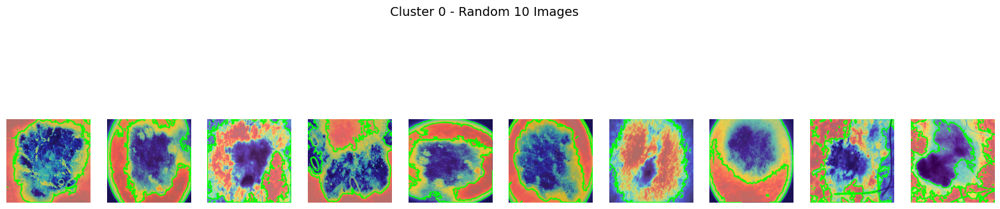

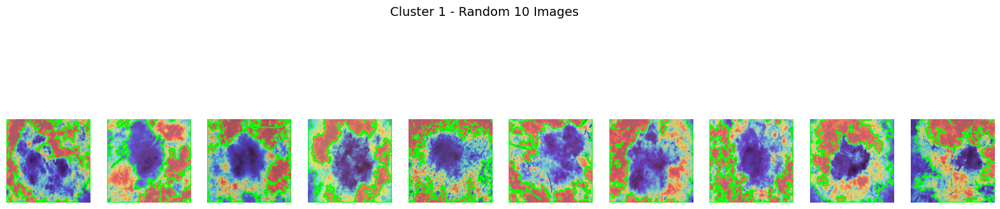

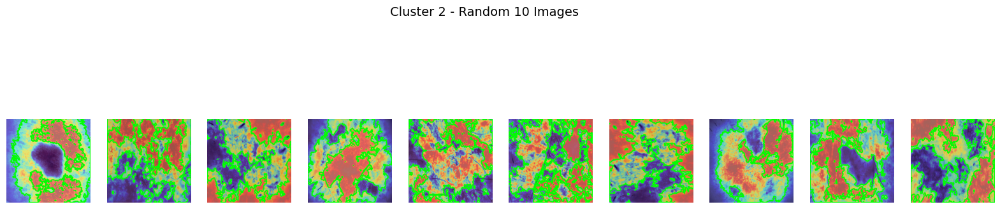

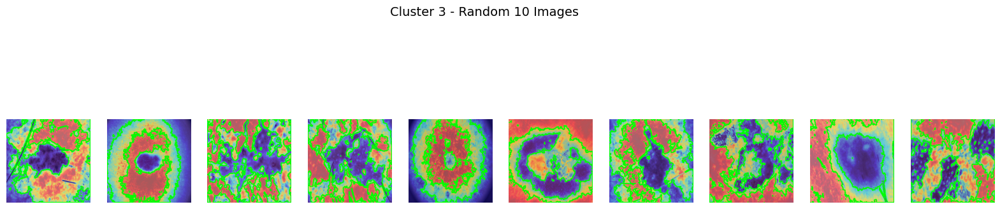

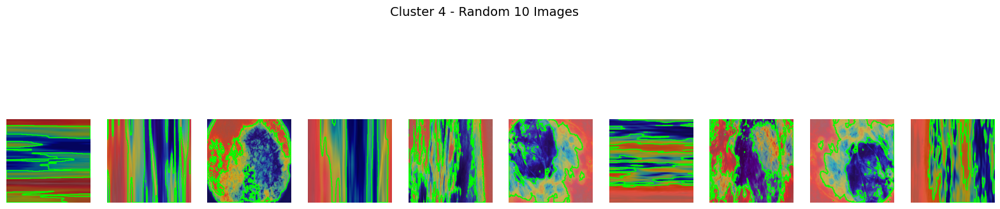

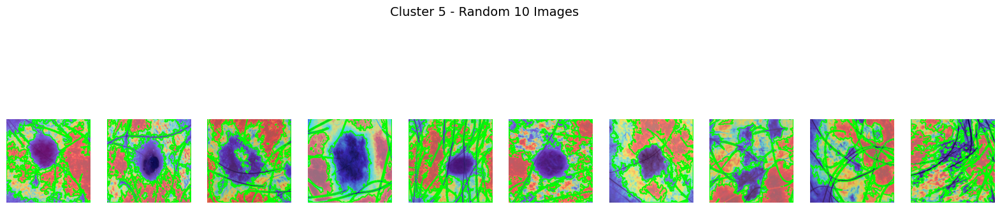

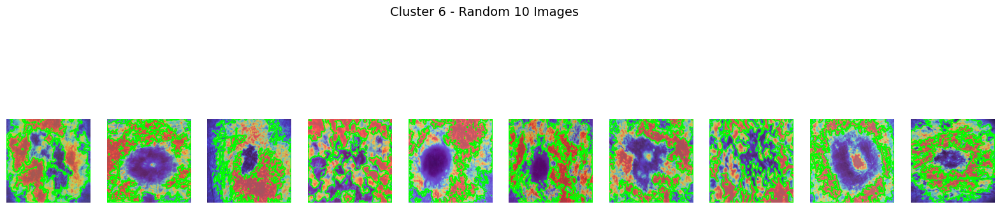

In [5]:
# المسار إلى البيانات
folder_path = "/kaggle/working/Augmented_Data2/"

# معالجة الصور واستخراج الخصائص
images, features, labels = process_images_and_extract_features(folder_path)

# تجميع الصور
clusters = cluster_images(features)
# عرض الصور في الكلاستر
visualize_clusters(images, clusters)

In [6]:
import cv2
import numpy as np
import os
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة وتحويلها إلى اللون الرمادي مع تحسين التباين وتغيير الحجم."""
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على نسخة من الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        area = cv2.contourArea(contour)
        total_area += area

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات على الصورة المدمجة."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

def extract_features(image, contours):
    """استخراج الخصائص الأساسية للصورة."""
    features = []
    if len(contours) > 0:
        c = max(contours, key=cv2.contourArea)
        area = cv2.contourArea(c)
        perimeter = cv2.arcLength(c, True)
    else:
        area, perimeter = 0, 0
    features.extend([area, perimeter])

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    mean_color = np.mean(hsv, axis=(0, 1))
    features.extend(mean_color)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = np.std(gray)
    features.append(texture)

    if len(contours) > 0:
        x, y, w, h = cv2.boundingRect(c)
        diameter = max(w, h)
    else:
        diameter = 0
    features.append(diameter)

    return features

def process_images_and_extract_features(folder_path):
    """معالجة الصور واستخراج الخصائص."""
    original_images = []
    merged_images = []
    feature_list = []
    labels = []

    for subdir, _, files in os.walk(folder_path):
        label = os.path.basename(subdir)
        for file in files:
            image_path = os.path.join(subdir, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)

            features = extract_features(merged_image, contours)
            feature_list.append(features)
            original_images.append(color_image)
            merged_images.append(merged_image)
            labels.append(label)

    return original_images, merged_images, np.array(feature_list), labels

def cluster_images(features, num_clusters=7):
    """تجميع الصور بناءً على الخصائص المستخرجة."""
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)
    return clusters

def visualize_clusters(original_images, merged_images, clusters):
    """عرض الصور الأصلية والدمجية ضمن كل مجموعة."""
    clustered_images = {i: [] for i in range(max(clusters) + 1)}

    for i in range(len(original_images)):
        clustered_images[clusters[i]].append((original_images[i], merged_images[i]))

    for cluster_id, images in clustered_images.items():
        num_images = min(5, len(images))
        if num_images > 0:
            plt.figure(figsize=(20, 10))
            for i in range(num_images):
                original, merged = images[i]
                plt.subplot(2, num_images, i + 1)
                plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title("Original")

                plt.subplot(2, num_images, num_images + i + 1)
                plt.imshow(cv2.cvtColor(merged, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title("Merged")

            plt.suptitle(f"Cluster {cluster_id}", fontsize=16)
            plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


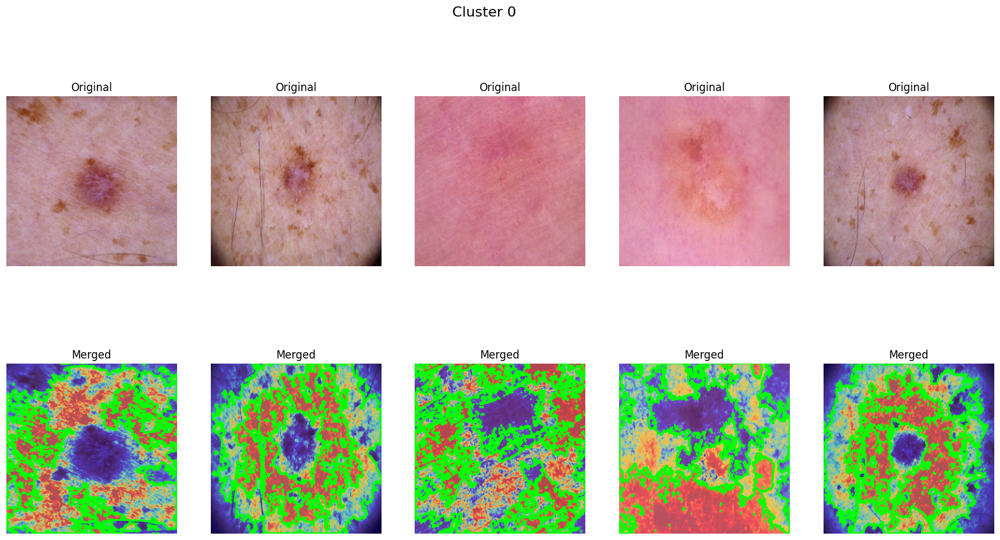

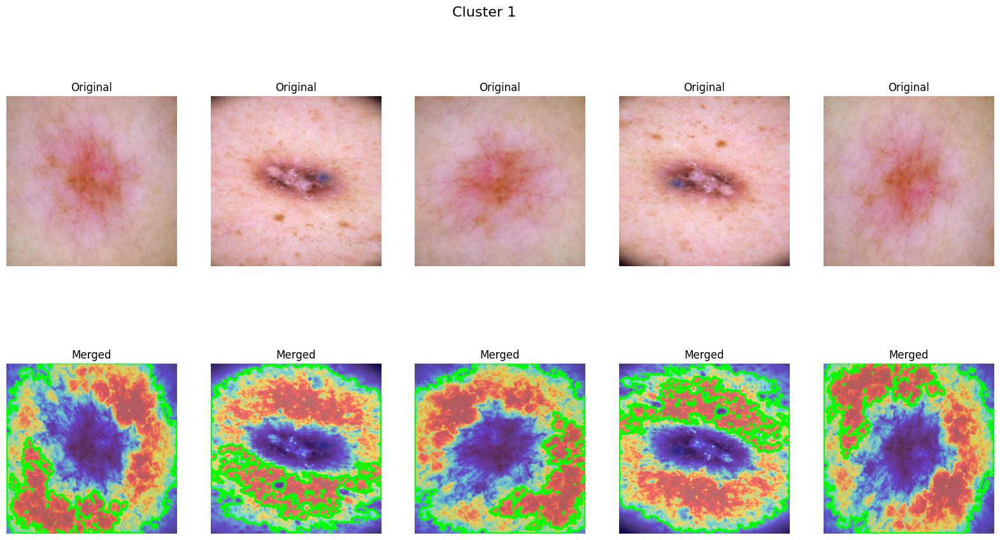

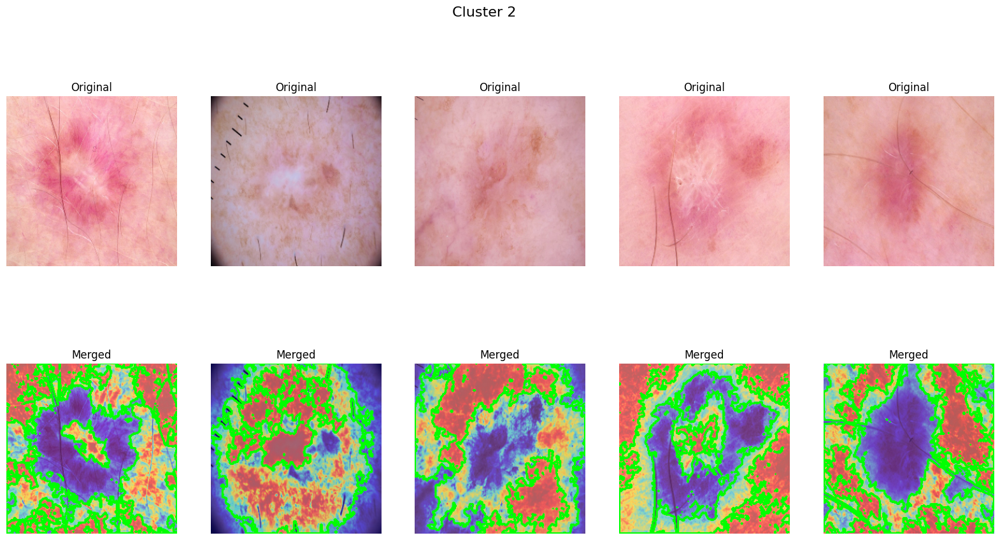

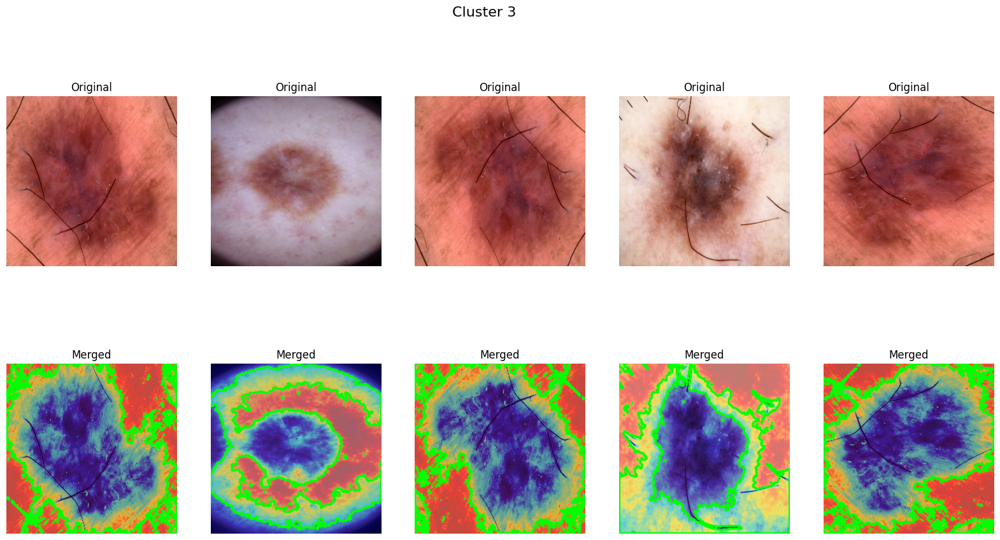

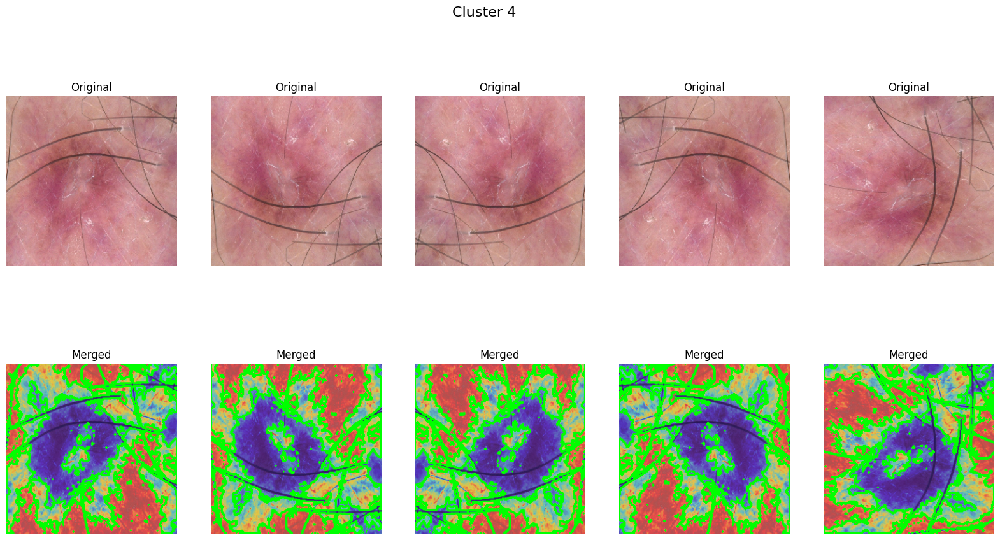

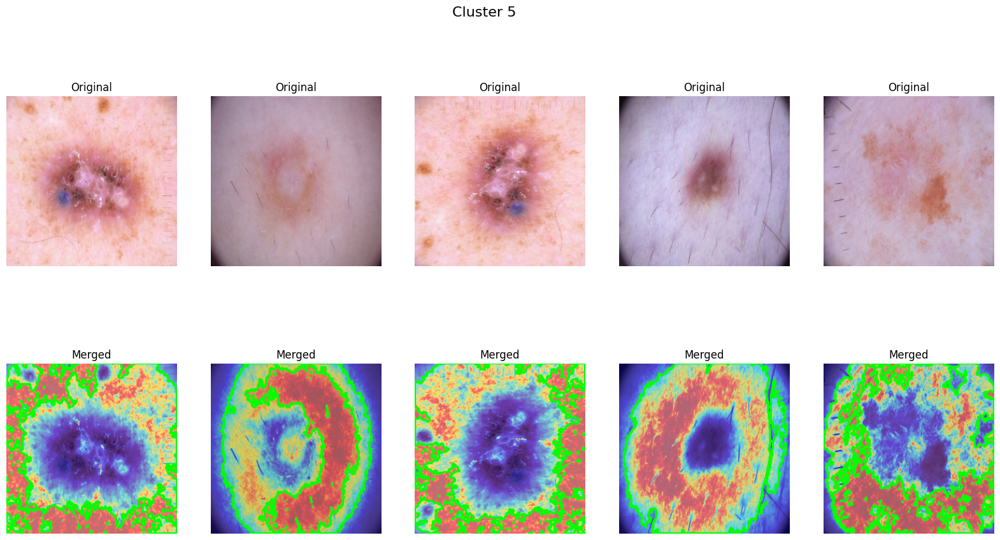

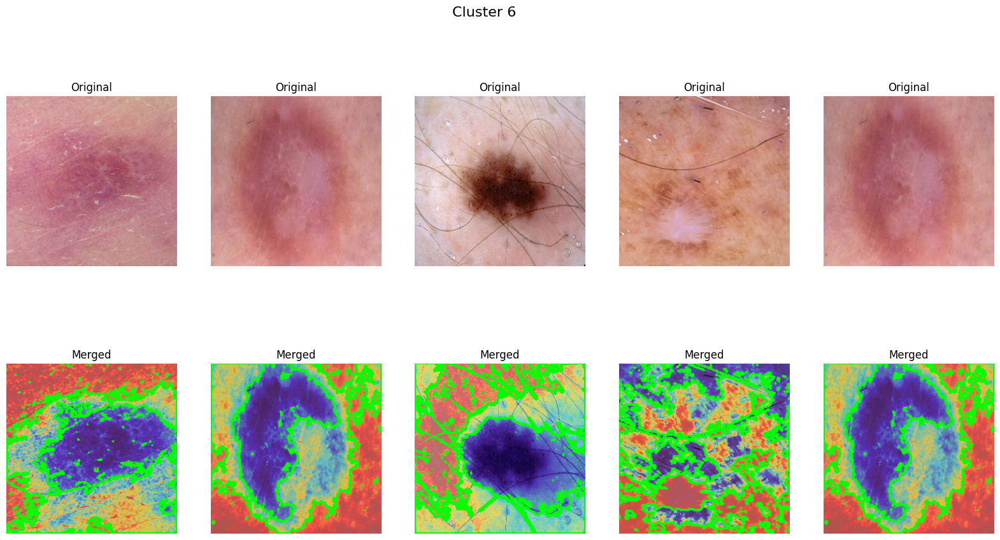

In [7]:
# المسار إلى البيانات
folder_path = "/kaggle/working/Augmented_Data2/"

# معالجة الصور واستخراج الخصائص
original_images, merged_images, features, labels = process_images_and_extract_features(folder_path)

# تجميع الصور
clusters = cluster_images(features)

# عرض الصور الأصلية والمُدمجة
visualize_clusters(original_images, merged_images, clusters)

Actinc Keratosis
Total Gray Area: 43914.5 pixels


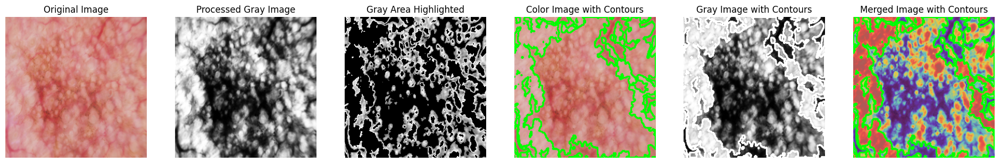

Total Gray Area: 29470.5 pixels


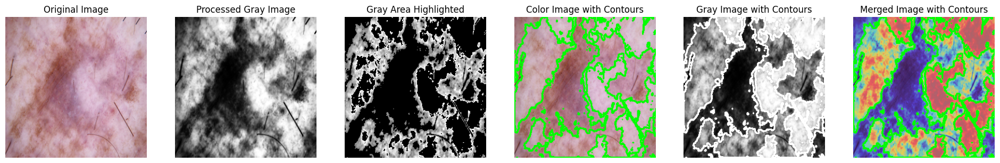

basal cell carcinoma
Total Gray Area: 32646.5 pixels


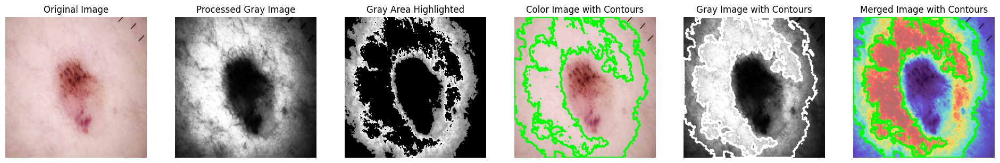

Total Gray Area: 29866.5 pixels


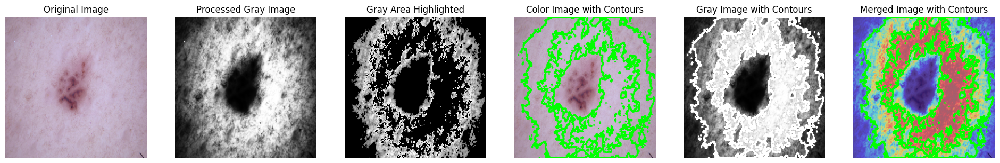

dermatofibroma
Total Gray Area: 25504.0 pixels


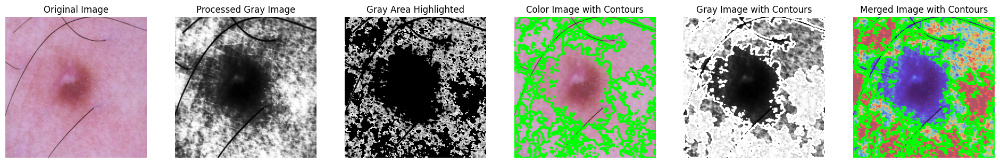

Total Gray Area: 45914.0 pixels


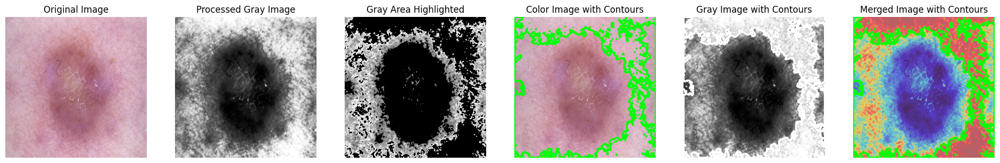

melanoma
Total Gray Area: 45224.5 pixels


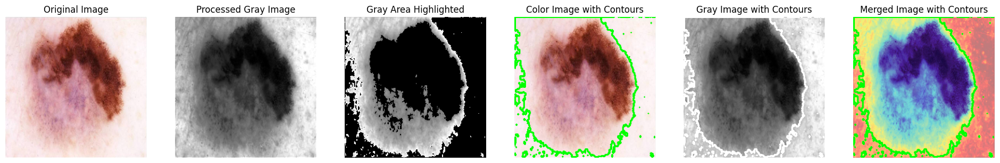

Total Gray Area: 41285.5 pixels


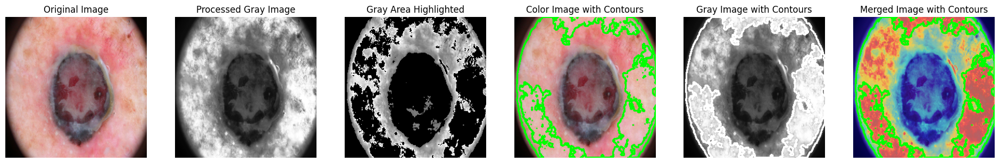

nevus
Total Gray Area: 41967.5 pixels


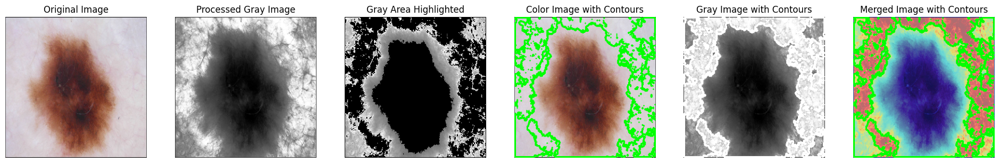

Total Gray Area: 24130.0 pixels


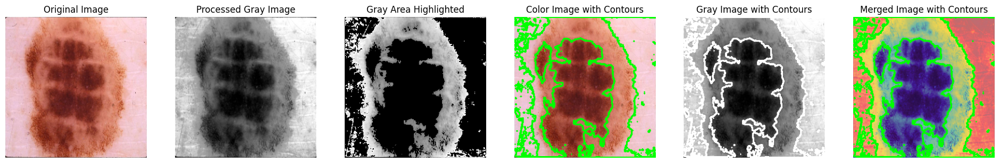

pigmented benign keratosis
Total Gray Area: 44934.0 pixels


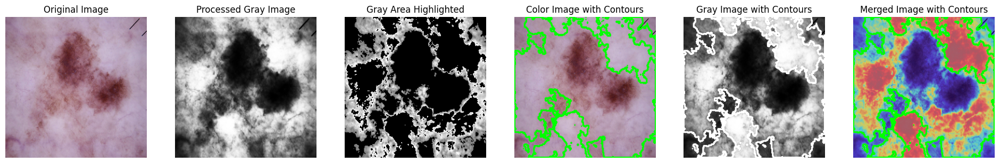

Total Gray Area: 43029.0 pixels


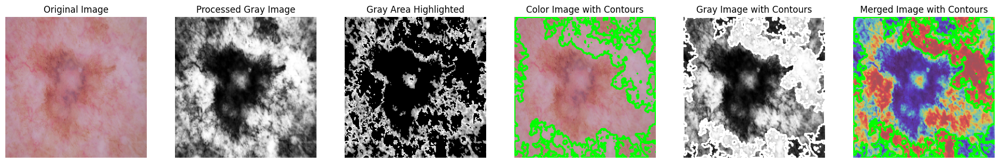

serbirrheic kertosis
Total Gray Area: 45956.5 pixels


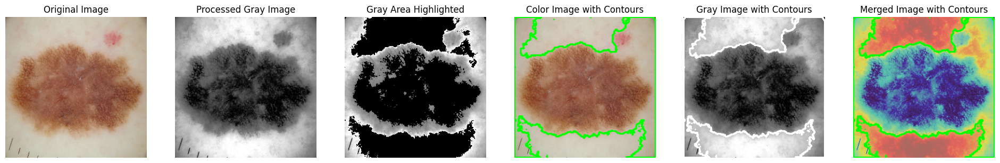

Total Gray Area: 24975.0 pixels


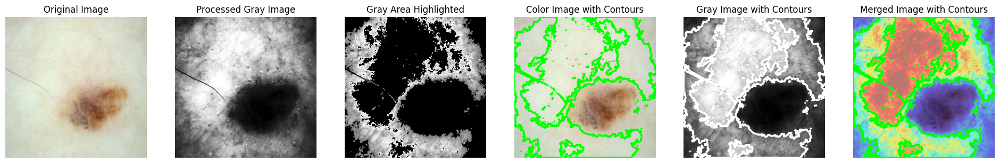

squamous cell carcinma
Total Gray Area: 24109.0 pixels


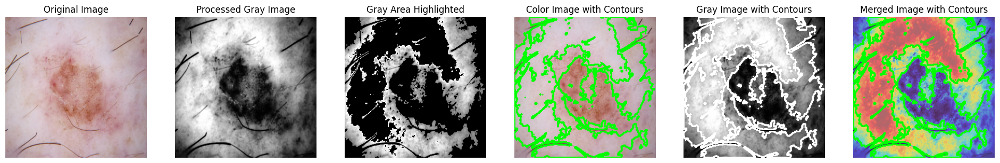

Total Gray Area: 26991.5 pixels


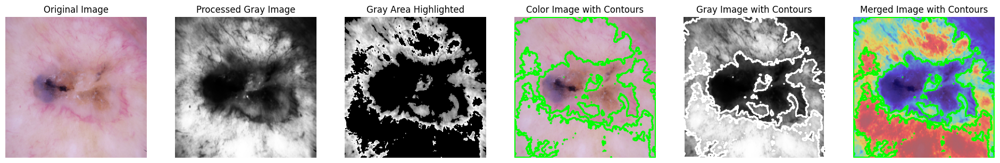

vascular lesion
Total Gray Area: 37746.5 pixels


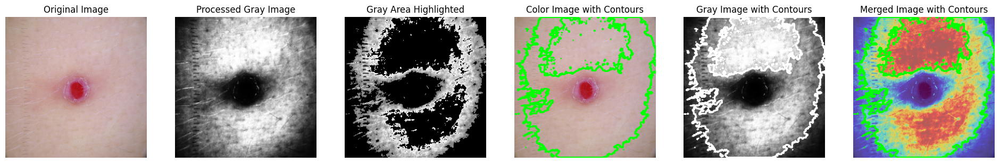

Total Gray Area: 30565.5 pixels


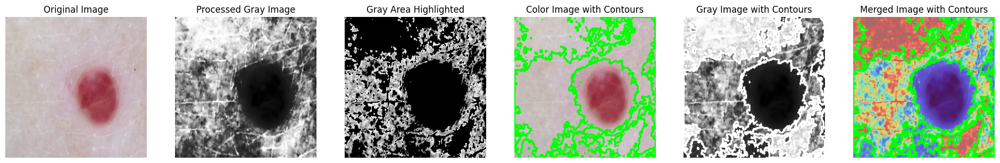

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة وتحويلها إلى اللون الرمادي مع تحسين التباين وتغيير الحجم."""
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)

    # تطبيق العتبة وتحديد المناطق الرمادية
    mask = apply_threshold(gray_resized)

    # العثور على المحيطات ورسمها
    color_with_contours, total_gray_area, contours = find_and_draw_contours(color_resized, mask)

    # رسم المحيطات على الصورة الرمادية
    gray_with_contours = gray_resized.copy()
    for contour in contours:
        cv2.drawContours(gray_with_contours, [contour], -1, (255, 255, 255), 2)


    return color_resized, gray_resized, gray_with_contours

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على نسخة من الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)  # اللون الأخضر
        area = cv2.contourArea(contour)
        total_area += area

    print(f"Total Gray Area: {total_area} pixels")
    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات على الصورة المدمجة."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    # رسم المحيطات على الصورة المدمجة
    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)  # اللون الأخضر

    return merged_image

def plot_images(image_list, titles):
    """عرض مجموعة من الصور جنبًا إلى جنب."""
    fig, axes = plt.subplots(1, len(image_list), figsize=(24, 5))
    for ax, img, title in zip(axes, image_list, titles):
        if len(img.shape) == 2:  # صورة رمادية
            ax.imshow(img, cmap='gray')
        else:  # صورة ملونة
            ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.set_title(title)
        ax.axis("off")
    plt.show()

def process_and_visualize_image(image_path):
    """الوظيفة الرئيسية لمعالجة الصورة وعرض النتائج."""
    color_resized, gray_resized = load_and_preprocess_image(image_path)

    # تطبيق العتبة وتحديد المناطق الرمادية
    mask = apply_threshold(gray_resized)

    # العثور على المحيطات ورسمها
    color_with_contours, total_gray_area, contours = find_and_draw_contours(color_resized, mask)

    # رسم المحيطات على الصورة الرمادية
    gray_with_contours = gray_resized.copy()
    for contour in contours:
        cv2.drawContours(gray_with_contours, [contour], -1, (255, 255, 255), 2)

    # دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات
    return gray_with_contours

# تجربة الكود على الصور
print("Actinc Keratosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0025992.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0026905.jpg")

print("basal cell carcinoma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/basal cell carcinoma/ISIC_0024665.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/basal cell carcinoma/ISIC_0024984.jpg")

print("dermatofibroma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/dermatofibroma/ISIC_0026417.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/dermatofibroma/ISIC_0025771.jpg")

print("melanoma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000166.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000144.jpg")

print("nevus")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/nevus/ISIC_0000063.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/nevus/ISIC_0000224.jpg")

print("pigmented benign keratosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/pigmented benign keratosis/ISIC_0025086.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/pigmented benign keratosis/ISIC_0024477.jpg")

print("serbirrheic kertosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/seborrheic keratosis/ISIC_0010990.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/seborrheic keratosis/ISIC_0010883.jpg")

print("squamous cell carcinma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/squamous cell carcinoma/ISIC_0026083.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/squamous cell carcinoma/ISIC_0025471.jpg")

print("vascular lesion")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/ISIC_0024669.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/ISIC_0025873.jpg")

Black borders found. Zooming in...


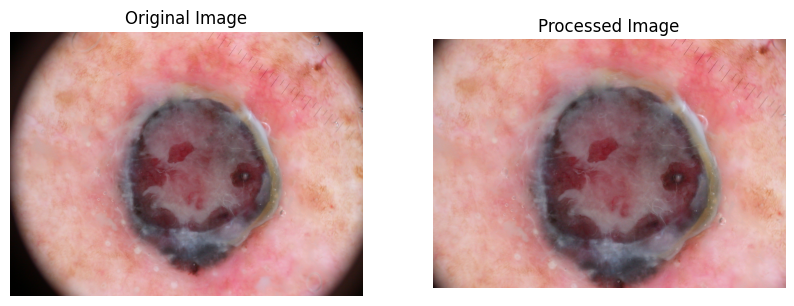

No black borders found. Keeping the original image.


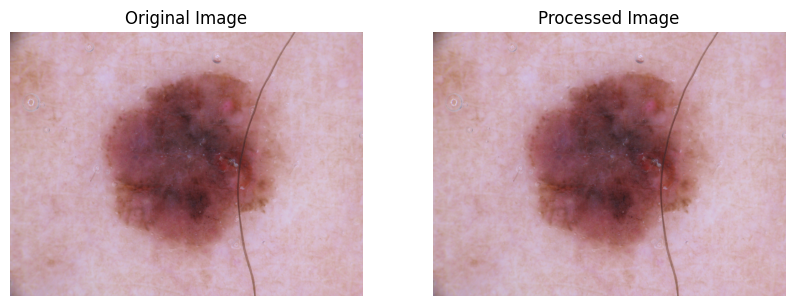

No black borders found. Keeping the original image.


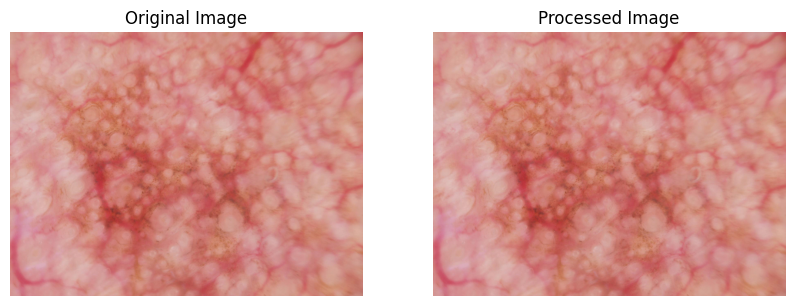

No black borders found. Keeping the original image.


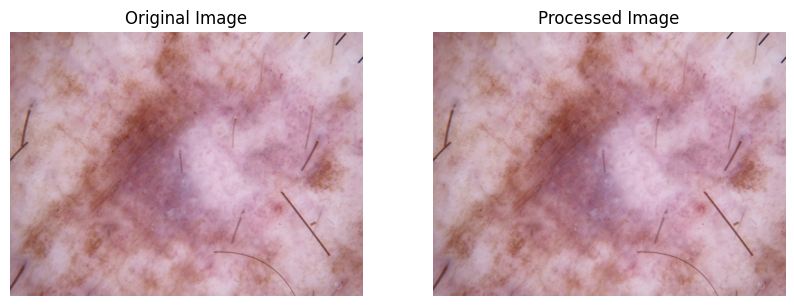

False

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def has_black_borders(img, threshold=10):
    """Check if the image has black borders."""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold  # Detect non-black areas
    return not np.all(mask)  # Returns True if borders exist

def zoom_until_no_borders(img, zoom_step=10):
    """Keep zooming in (cropping) until no black borders remain."""
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step

        if x_min >= x_max or y_min >= y_max:
            break  # Stop if image becomes too small

        img = img[y_min:y_max, x_min:x_max]

    return img

def process_image(image_path):
    """Load the image, check for black borders, and zoom in if necessary."""
    img = cv2.imread(image_path)

    if has_black_borders(img):
        print("Black borders found. Zooming in...")
        img = zoom_until_no_borders(img)
    else:
        print("No black borders found. Keeping the original image.")

    return img

def show_images_side_by_side(original, processed):
    """Display the original and processed images side by side."""
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Convert BGR to RGB for correct display
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    processed_rgb = cv2.cvtColor(processed, cv2.COLOR_BGR2RGB)

    axes[0].imshow(original_rgb)
    axes[0].set_title("Original Image")
    axes[0].axis("off")

    axes[1].imshow(processed_rgb)
    axes[1].set_title("Processed Image")
    axes[1].axis("off")

    plt.show()

# Load and process the image
image_path = "/kaggle/working/Augmented_Data2/melanoma/ISIC_0000144.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)

# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000139.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)


# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0025992.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)

# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0026905.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)
